In [1]:
# Import libraries
import os 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn

In [2]:
# Local functions to be utilized

def check_num_of_Nones(dataset):
    print("Satjob: ", dataset["satjob"].value_counts())
    print("Satfin: ", dataset["satfin"].value_counts())

In [3]:
#Load the merged dataset

dataset = pd.read_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df.parquet")

In [4]:
# Get the GSS data columns with negative values
dataset = dataset.reset_index(drop=True)

# 1. Filter only rows where both satfin and satjob are not null
subset = dataset[dataset["satfin"].notna() & dataset["satjob"].notna()]

# 2. Identify numeric columns
num_cols = subset.select_dtypes(include="number").columns

# 3. Create a boolean mask of negative values
neg_mask = (subset[num_cols] < 0)

# 4. Count how many negatives per column
neg_counts = neg_mask.sum().sort_values(ascending=False)
print("Columns with negative values:\n", neg_counts[neg_counts > 0])


Columns with negative values:
 income     32208
rincome    13105
sei10       4237
dtype: int64


# Missing values treatment
We will use MICE with the BayesianRidge algorithm to fill in the missing values for: dwelown, phone, age, BPL, hrs2, weekswrk, prestg10.

The algorithm learns the posterior mean of each weight (the most likely line) and the posterior variance (how uncertain we are about it), which ultimately gives a distribution over possible lines, not just one, and therefore is amazing for filling in missing values in a large and potentially noisy dataset.

In [5]:
# Missing values
dataset.isnull().sum()

year               0
dwelown           27
phone           1310
famgen             0
sex                0
age              867
marital            0
race               0
hispanic           0
BPL            32208
degree             0
wrkstat            0
wrkslf             0
occ10              0
indus10            0
hrs2           31582
weekswrk       12673
income             0
rincome            0
sei10              0
prestg10        4237
hompop             0
satjob      28065045
satfin      28065045
dtype: int64

In [6]:
# Let's turn the invalid data from the GSS dataset to Nulls to have them substituted with Beyesian later
# Negative values
targets = ["rincome", "income", "hrs2", "weekswrk", "age", "sei10"]

for column in targets:
    print(f"Fixed {len(dataset[(dataset[column] < 0) & dataset["satfin"].notna() & dataset["satjob"].notna()])} rows with negative {column}.")
    dataset.loc[(dataset[column] < 0) & dataset["satfin"].notna() & dataset["satjob"].notna(), column] = None

# dwelown's value = 0 is inapplicable
mask = (
(dataset["dwelown"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "dwelown"] = None
print(f"Fixed {mask.sum()} rows with invalid dwelown.")

# famgen's value = 0 is inapplicable
mask = (
(dataset["famgen"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
print(f"Fixed {mask.sum()} rows with invalid famgen.")

# phone's value = 8 is suppressed
# phone's value = 3 is inapplicable
mask = (
(
    (dataset["phone"].astype(float) == 8.0)
    | (dataset["phone"].astype(float) == 3.0)
)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "phone"] = None
print(f"Fixed {mask.sum()} rows with invalid phone.")

# sex's value = 9 is missing / blank
mask = (
(dataset["sex"].astype(float) == 9.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "sex"] = None
print(f"Fixed {mask.sum()} rows with invalid sex.")

# marital's value = 9 is missing / blank
mask = (
(dataset["marital"].astype(float) == 9.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "marital"] = None
print(f"Fixed {mask.sum()} rows with invalid marital.")

# degree's value = 0 is inapplicable / missing / invalid
mask = (
(dataset["degree"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "degree"] = None
print(f"Fixed {mask.sum()} rows with invalid degree.")

# race is in a good condition, no inapplicable values

# hispanic's value = 9 is inapplicable
mask = (
(dataset["hispanic"].astype(float) == 9.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "hispanic"] = None
print(f"Fixed {mask.sum()} rows with invalid hispanic.")

# wrkstat's value = 9 is inapplicable
mask = (
(dataset["wrkstat"].astype(float) == 9.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "wrkstat"] = None
print(f"Fixed {mask.sum()} rows with invalid wrkstat.")

# wrkslf's value = 0 is inapplicable / missing / invalid
mask = (
(dataset["wrkslf"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "wrkslf"] = None
print(f"Fixed {mask.sum()} rows with invalid wrkslf.")

# occ10's value = 0 is inapplicable / missing / invalid
mask = (
(dataset["occ10"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "occ10"] = None
print(f"Fixed {mask.sum()} rows with invalid occ10.")

# indus10's value = 0 is inapplicable / missing / invalid
mask = (
(dataset["indus10"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "indus10"] = None
print(f"Fixed {mask.sum()} rows with invalid indus10.")

# prestg10's value = 0 is inapplicable / missing / invalid
mask = (
(dataset["prestg10"].astype(float) == 0.0)
& dataset["satfin"].notna()
& dataset["satjob"].notna()
)
dataset.loc[mask, "prestg10"] = None
print(f"Fixed {mask.sum()} rows with invalid prestg10.")


# Preserve the original valid satfin and satjob
notna_satfin = dataset["satfin"].notna()
notna_satjob = dataset["satjob"].notna()

# satjob's value = 0 and 9 are invalid
mask = (
(
    (dataset["satjob"].astype(float) == 0.0)
    | (dataset["satjob"].astype(float) == 9.0)
)
& notna_satfin
)
dataset.loc[mask, "satjob"] = None
print(f"Fixed {mask.sum()} rows with invalid satjob.")

# satfin's value = 0 and 9 are invalid
mask = (
(
    (dataset["satfin"].astype(float) == 0.0)
    | (dataset["satfin"].astype(float) == 9.0)
)
& notna_satjob
)
dataset.loc[mask, "satfin"] = None
print(f"Fixed {mask.sum()} rows with invalid satfin.")

Fixed 13105 rows with negative rincome.
Fixed 32208 rows with negative income.
Fixed 0 rows with negative hrs2.
Fixed 0 rows with negative weekswrk.
Fixed 0 rows with negative age.
Fixed 4237 rows with negative sei10.
Fixed 13660 rows with invalid dwelown.
Fixed 4389 rows with invalid famgen.
Fixed 0 rows with invalid phone.
Fixed 112 rows with invalid sex.
Fixed 52 rows with invalid marital.
Fixed 3996 rows with invalid degree.
Fixed 129 rows with invalid hispanic.
Fixed 31 rows with invalid wrkstat.
Fixed 4019 rows with invalid wrkslf.
Fixed 10785 rows with invalid occ10.
Fixed 4476 rows with invalid indus10.
Fixed 0 rows with invalid prestg10.
Fixed 11499 rows with invalid satjob.
Fixed 3854 rows with invalid satfin.


In [7]:
# Missing values
dataset.isnull().sum()

year               0
dwelown        13687
phone           1310
famgen             0
sex              112
age              867
marital           52
race               0
hispanic         129
BPL            32208
degree          3996
wrkstat           31
wrkslf          4019
occ10          10785
indus10         4476
hrs2           31582
weekswrk       12673
income         32208
rincome        13105
sei10           4237
prestg10        4237
hompop             0
satjob      28076544
satfin      28068899
dtype: int64

In [8]:
import numpy as np
from sklearn.experimental import enable_iterative_imputer  # noqa
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge
import pyarrow as pa
import pyarrow.parquet as pq

# Columns to be imputed
feature_columns = dataset.drop(columns=["satfin","satjob"]).columns
target = [ title for title in feature_columns if (dataset[title].isnull().sum()>0) ]
print(f"Targets({len(target)}) to be imputed: {target}")

# Predictors
features = [c for c in dataset.columns if c not in ("satfin", "satjob")]

# Categorical-like columns
categorical_like_tobe_rounded = ["year", "dwelown", "phone", "famgen", "sex", "age", "marital", "race", 
                                 "hispanic", "BPL", "degree", "wrkstat", "wrkslf", "occ10", "indus10", "hompop"]

# Configs
RNG = np.random.RandomState(123)
CHUNK_SIZE = 1_000_000
FIT_SAMPLE_SIZE = 500_000

# Fit and Transform
if len(dataset) > FIT_SAMPLE_SIZE:
    fit_idx = RNG.choice(dataset.index, size=FIT_SAMPLE_SIZE, replace=False)
    X_fit = dataset.loc[fit_idx, features]
else:
    X_fit = dataset[features]

imp = IterativeImputer(
    estimator=BayesianRidge(),
    max_iter=10,
    sample_posterior=True,      
    initial_strategy="median",     
    n_nearest_features=16,        
    imputation_order="ascending",  
    random_state=123
)
imp.fit(X_fit)

# Save in chunks
out_path = "/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet"
writer = None

n = len(dataset)
for start in range(0, n, CHUNK_SIZE):
    end = min(start + CHUNK_SIZE, n)

    # Pull the chunk of predictors
    X_chunk = dataset.iloc[start:end][features]

    # Impute this chunk only
    X_imp_arr = imp.transform(X_chunk)

    # Wrap back to DataFrame to keep column alignment
    X_imp_df = pd.DataFrame(X_imp_arr, columns=features, index=dataset.index[start:end])

    # Build output rows: copy original, replace ONLY target cols
    out_chunk = dataset.iloc[start:end].copy()
    out_chunk[target] = X_imp_df[target]

    # Round categorical-like codes back to integers
    for feature in categorical_like_tobe_rounded:
        if feature in target:
            print(f"Rounding {feature}")
            out_chunk[feature] = out_chunk[feature].round().astype("Int64")

    # Append this chunk as a row group to a single parquet file
    table = pa.Table.from_pandas(out_chunk, preserve_index=False)
    if writer is None:
        writer = pq.ParquetWriter(out_path, table.schema, compression="zstd")
    writer.write_table(table)

    print(f"wrote rows {start:,}–{end-1:,} / {n:,}")

if writer is not None:
    writer.close()

print(f"Done. Saved: {out_path}")



Targets(18) to be imputed: ['dwelown', 'phone', 'sex', 'age', 'marital', 'hispanic', 'BPL', 'degree', 'wrkstat', 'wrkslf', 'occ10', 'indus10', 'hrs2', 'weekswrk', 'income', 'rincome', 'sei10', 'prestg10']
Rounding dwelown
Rounding phone
Rounding sex
Rounding age
Rounding marital
Rounding hispanic
Rounding BPL
Rounding degree
Rounding wrkstat
Rounding wrkslf
Rounding occ10
Rounding indus10
wrote rows 0–999,999 / 28,097,253
Rounding dwelown
Rounding phone
Rounding sex
Rounding age
Rounding marital
Rounding hispanic
Rounding BPL
Rounding degree
Rounding wrkstat
Rounding wrkslf
Rounding occ10
Rounding indus10
wrote rows 1,000,000–1,999,999 / 28,097,253
Rounding dwelown
Rounding phone
Rounding sex
Rounding age
Rounding marital
Rounding hispanic
Rounding BPL
Rounding degree
Rounding wrkstat
Rounding wrkslf
Rounding occ10
Rounding indus10
wrote rows 2,000,000–2,999,999 / 28,097,253
Rounding dwelown
Rounding phone
Rounding sex
Rounding age
Rounding marital
Rounding hispanic
Rounding BPL
Roundi

# Sanity check
## after fitting the missing values for the attributes with the small percentage of rows missing

In [19]:
# Switch to the new dataset
dataset = pd.read_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

In [20]:
# Missing values
dataset.isnull().sum()

year               0
dwelown            0
phone              0
famgen             0
sex                0
age                0
marital            0
race               0
hispanic           0
BPL                0
degree             0
wrkstat            0
wrkslf             0
occ10              0
indus10            0
hrs2               0
weekswrk           0
income             0
rincome            0
sei10              0
prestg10           0
hompop             0
satjob      28076544
satfin      28068899
dtype: int64

In [21]:
print("\n\n-- Overall info --")
print(dataset.info(verbose=True))



-- Overall info --
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28097253 entries, 0 to 28097252
Data columns (total 24 columns):
 #   Column    Dtype  
---  ------    -----  
 0   year      int64  
 1   dwelown   Int64  
 2   phone     Int64  
 3   famgen    int64  
 4   sex       Int64  
 5   age       Int64  
 6   marital   Int64  
 7   race      int64  
 8   hispanic  Int64  
 9   BPL       Int64  
 10  degree    Int64  
 11  wrkstat   Int64  
 12  wrkslf    Int64  
 13  occ10     Int64  
 14  indus10   Int64  
 15  hrs2      float64
 16  weekswrk  float64
 17  income    float64
 18  rincome   float64
 19  sei10     float64
 20  prestg10  float64
 21  hompop    int64  
 22  satjob    float64
 23  satfin    float64
dtypes: Int64(12), float64(8), int64(4)
memory usage: 5.3 GB
None


# Outlier treatment

In [22]:
# Calculate variance
print(dataset.var().sort_values(ascending=False))

income      3205134775812.077637
rincome        2586905665.517191
occ10             11283673.01915
BPL                 16028.418541
hrs2                  859.187174
sei10                 809.839668
prestg10              536.897957
age                   312.200678
year                   60.585961
indus10                 7.722549
degree                  5.970007
marital                 4.369571
race                    3.250614
hompop                  2.591213
weekswrk                2.172854
wrkstat                 0.920854
wrkslf                  0.759928
satjob                  0.642794
hispanic                0.566361
satfin                  0.560359
famgen                  0.443537
sex                     0.249719
dwelown                 0.232576
phone                   0.165611
dtype: Float64


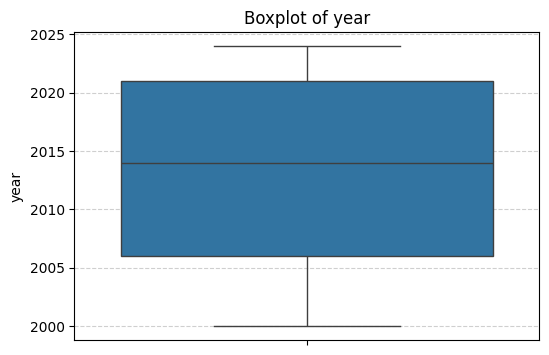

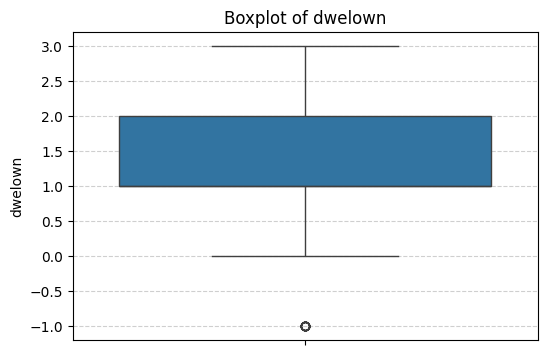

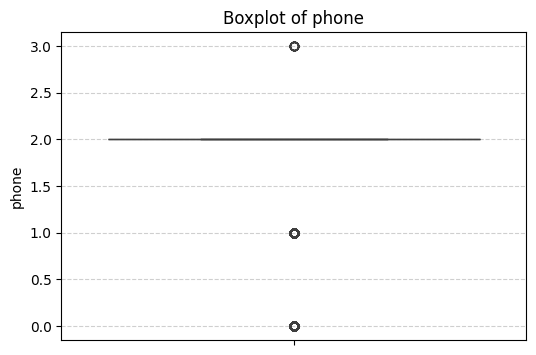

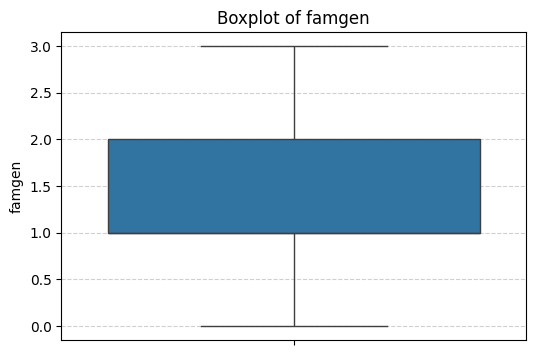

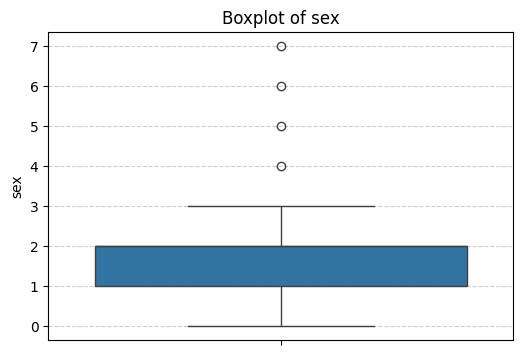

...

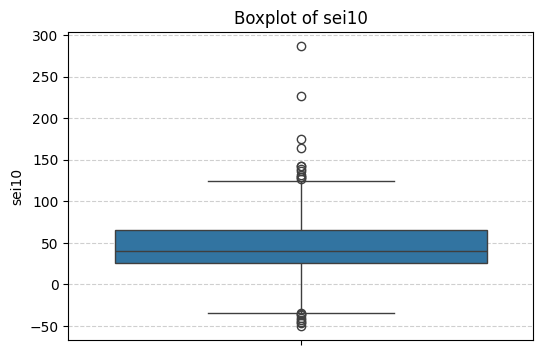

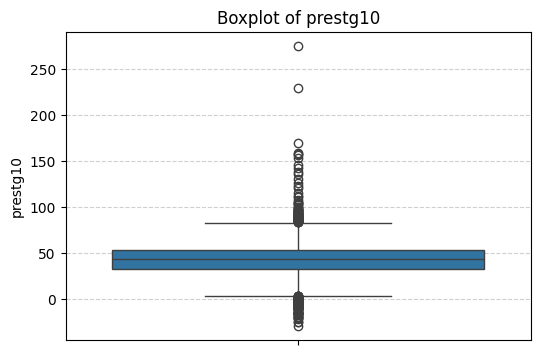

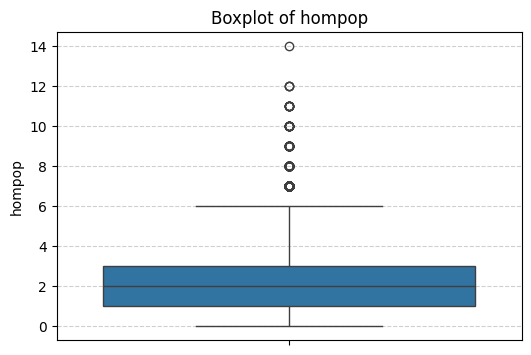

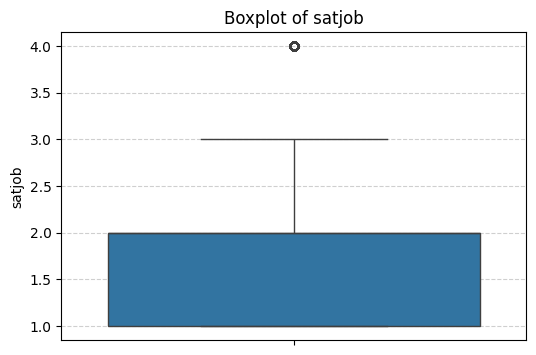

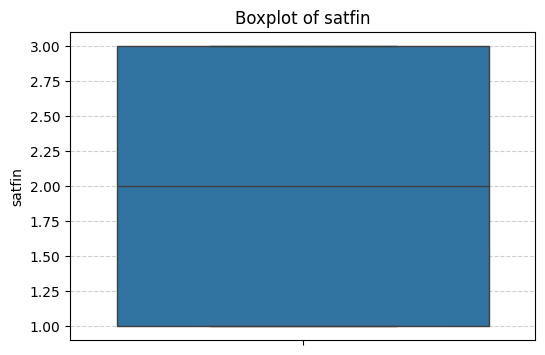

In [13]:
# Let's see if there are any outliers:
num_df = dataset.select_dtypes(include="number").dropna()

for col in num_df.columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(y=num_df[col].dropna())
    plt.title(f"Boxplot of {col}")
    plt.ylabel(col)
    plt.grid(True, axis='y', linestyle='--', alpha=0.6)
    plt.show()

In [23]:
# Let's see what the value counts for every attribute
for column in dataset.columns:
    print("\n\n", column, ": ", dataset[column].value_counts())




 year :  year
2000    8666593
2022    2231382
2018    2066582
2006    2054001
2016    2028724
2014    1998606
2012    1959798
2010    1912223
2008    1885452
2020    1727406
2004     820409
2002     739783
2021       3437
2024       2857
Name: count, dtype: int64


 dwelown :  dwelown
1     20335206
2      6817511
0       944397
3          105
-1          34
Name: count, dtype: Int64


 phone :  phone
2    26580756
0      945184
1      556995
8       14276
3          42
Name: count, dtype: Int64


 famgen :  famgen
1    13428248
2    11945599
3     1776023
0      947383
Name: count, dtype: int64


 sex :  sex
2    14522061
1    13575182
0           4
3           2
4           1
6           1
5           1
7           1
Name: count, dtype: Int64


 age :  age
50     560226
53     547577
52     547317
45     546121
40     541062
        ...  
168         1
10          1
6           1
5           1
118         1
Name: count, Length: 105, dtype: Int64


 marital :  marital
1     16045734

In [24]:
# Attributes with continuous numeric data:
continuous_numeric_attrs = ["rincome", "income", "hrs2", "weekswrk", "age", "sei10", "hompop"] 

In [25]:
# Let's delete all of the rows with negative continuous numeric data
dataset = dataset[(dataset[continuous_numeric_attrs] >= 0).all(axis=1)]

In [26]:
# Cut the outliers among the attributes with the continuous numeric data
def whisker(attr):
    q1, q3 = np.percentile(attr, [25, 75]) 
    iqr = q3 - q1
    lw = q1 - 2*iqr
    uw = q3 + 2*iqr
    
    return lw, uw

print("Before")
check_num_of_Nones(dataset)
print("\n\n")

for attr in continuous_numeric_attrs:
    lw, uw = whisker(dataset[attr])

    # Create a mask for values **within** the IQR whiskers
    mask = ((dataset[attr] >= lw) & (dataset[attr] <= uw)) | (dataset["satfin"].notna())

    # Count how many rows will be removed for this column
    removed_count = (~mask).sum()
    print(f"{attr}: {removed_count} rows removed")

    # Keep only rows inside the whisker range
    dataset = dataset[mask]

print("Final shape:", dataset.shape)

print("\n\nAfter")
check_num_of_Nones(dataset)

Before
Satjob:  satjob
1.0    5828
2.0    4673
3.0    1079
4.0     459
Name: count, dtype: int64
Satfin:  satfin
2.0    6729
1.0    4358
3.0    3981
Name: count, dtype: int64



rincome: 952926 rows removed
income: 1596429 rows removed
hrs2: 177 rows removed
weekswrk: 4 rows removed
age: 0 rows removed
sei10: 0 rows removed
hompop: 200926 rows removed
Final shape: (25291333, 24)


After
Satjob:  satjob
1.0    5720
2.0    4595
3.0    1067
4.0     450
Name: count, dtype: int64
Satfin:  satfin
2.0    6729
1.0    4358
3.0    3981
Name: count, dtype: int64


In [27]:
# Now we will remove the rows with invalid categorical data
print("Initial.")
check_num_of_Nones(dataset)
print("\n\n")

# dwelown's value <= 0 is inapplicable
before = len(dataset)
dataset = dataset[dataset["dwelown"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid dwelown.")

# famgen's value = 0 is inapplicable
before = len(dataset)
dataset = dataset[dataset["famgen"].astype(float) != 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid famgen.")

# phone's value = 8 is suppressed
# phone's value = 3 is inapplicable
before = len(dataset)
dataset = dataset[dataset["phone"].astype(float) != 8.0]
dataset = dataset[dataset["phone"].astype(float) != 3.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid phone.")

# sex's value = 9, 6, 0 is missing / blank
before = len(dataset)
dataset = dataset[dataset["sex"].astype(float) != 9.0]
dataset = dataset[dataset["sex"].astype(float) != 6.0]
dataset = dataset[dataset["sex"].astype(float) != 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid sex.")

# marital's value = 9 is missing / blank
# marital's <= 0 is invalid
before = len(dataset)
dataset = dataset[dataset["marital"].astype(float) != 9.0]
dataset = dataset[dataset["marital"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid marital.")

# degree's value = 0 is inapplicable / missing / invalid
before = len(dataset)
dataset = dataset[dataset["degree"].astype(float) != 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid degree.")

# race is in a good condition, no inapplicable values

# hispanic's value = 9 is inapplicable
before = len(dataset)
dataset = dataset[dataset["hispanic"].astype(float) != 9.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid hispanic.")

# BPL's negative value is inapplicable
before = len(dataset)
dataset = dataset[dataset["BPL"].astype(float) >= 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid BPL.")

# Degree's negative value is inapplicable
before = len(dataset)
dataset = dataset[dataset["degree"].astype(float) >= 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid degree.")

# wrkstat's value = 9 and negative values are inapplicable
before = len(dataset)
dataset = dataset[dataset["wrkstat"].astype(float) != 9.0]
dataset = dataset[dataset["wrkstat"].astype(float) >= 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid wrkstat.")

# wrkslf's value = 0 and negative values are inapplicable
before = len(dataset)
dataset = dataset[dataset["wrkslf"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid wrkslf.")

# occ10's value = 0 and negative values are inapplicable
before = len(dataset)
dataset = dataset[dataset["occ10"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid occ10.")

# indus10's value = 0 and negative values are inapplicable
before = len(dataset)
dataset = dataset[dataset["indus10"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid indus10.")

# prestg10's value = 0 and negative values are
before = len(dataset)
dataset = dataset[dataset["prestg10"].astype(float) > 0.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid prestg10.")

# satjob's value = 0 and 9 are are invalid
before = len(dataset)
dataset = dataset[dataset["satjob"].astype(float) != 0.0]
dataset = dataset[dataset["satjob"].astype(float) != 9.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid satjob.")

# satfin's value = 0 and 9 are are invalid
before = len(dataset)
dataset = dataset[dataset["satfin"].astype(float) != 0.0]
dataset = dataset[dataset["satfin"].astype(float) != 9.0]
after = len(dataset)
print(f"Removed {before - after} rows with invalid satfin.")

print("\n\nFinal")
check_num_of_Nones(dataset)


Initial.
Satjob:  satjob
1.0    5720
2.0    4595
3.0    1067
4.0     450
Name: count, dtype: int64
Satfin:  satfin
2.0    6729
1.0    4358
3.0    3981
Name: count, dtype: int64



Removed 864 rows with invalid dwelown.
Removed 2677 rows with invalid famgen.
Removed 13276 rows with invalid phone.
Removed 2 rows with invalid sex.
Removed 2 rows with invalid marital.
Removed 3356723 rows with invalid degree.
Removed 0 rows with invalid hispanic.
Removed 3308 rows with invalid BPL.
Removed 162 rows with invalid degree.
Removed 0 rows with invalid wrkstat.
Removed 5059855 rows with invalid wrkslf.
Removed 802 rows with invalid occ10.
Removed 2 rows with invalid indus10.
Removed 79875 rows with invalid prestg10.
Removed 0 rows with invalid satjob.
Removed 0 rows with invalid satfin.


Final
Satjob:  satjob
1.0    2705
2.0    2138
3.0     494
4.0     232
Name: count, dtype: int64
Satfin:  satfin
2.0    3176
1.0    2113
3.0    1825
Name: count, dtype: int64


In [28]:
# Let's see what the value counts for every attribute are now
for column in dataset.columns:
    print("\n\n", column, ": ", dataset[column].value_counts())



 year :  year
2000    5404172
2006    1301472
2022    1196357
2018    1174739
2014    1158472
2016    1154407
2010    1146981
2008    1146073
2012    1132279
2020     937225
2004     534682
2002     485845
2021       1081
Name: count, dtype: int64


 dwelown :  dwelown
1    12528745
2     4245032
3           8
Name: count, dtype: Int64


 phone :  phone
2    16464505
1      308533
0         747
Name: count, dtype: Int64


 famgen :  famgen
2    8179680
1    7670923
3     923182
Name: count, dtype: int64


 sex :  sex
2    8431630
1    8342155
Name: count, dtype: Int64


 age :  age
50     396808
45     392719
40     390785
47     386220
52     385456
        ...  
10          1
149         1
13          1
11          1
16          1
Name: count, Length: 88, dtype: Int64


 marital :  marital
1    10067087
6     3546136
4     2080482
5      498301
3      333389
2      248390
Name: count, dtype: Int64


 race :  race
1    13454998
2     1488073
7      543654
6      490410
8      410484

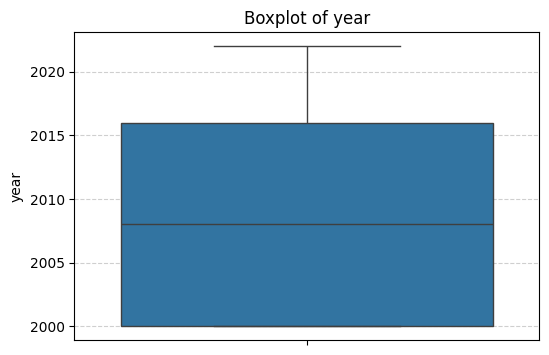

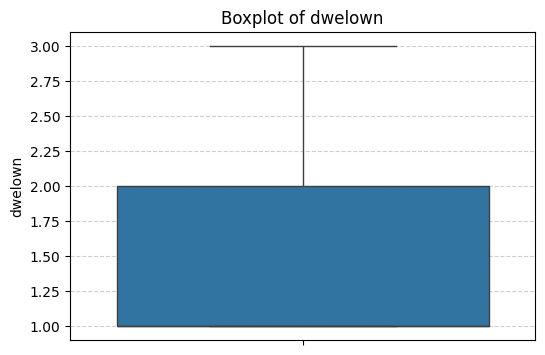

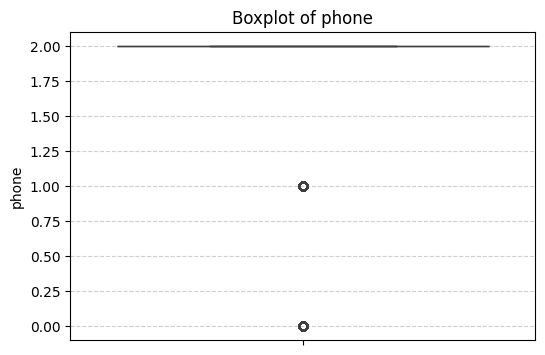

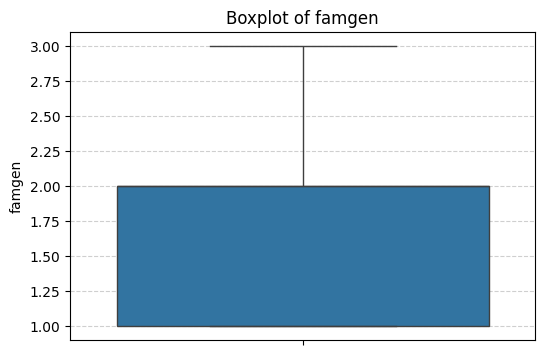

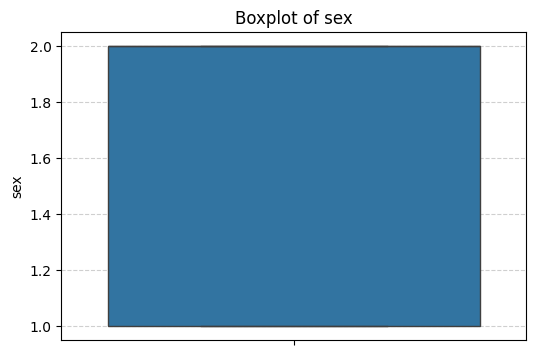

...

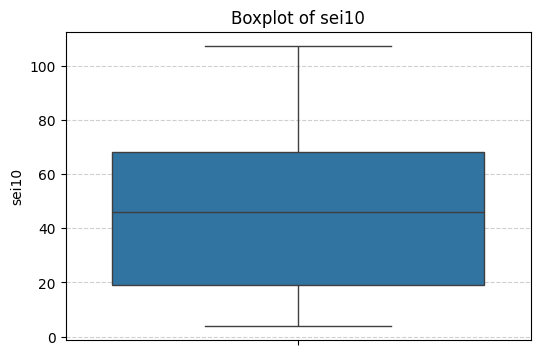

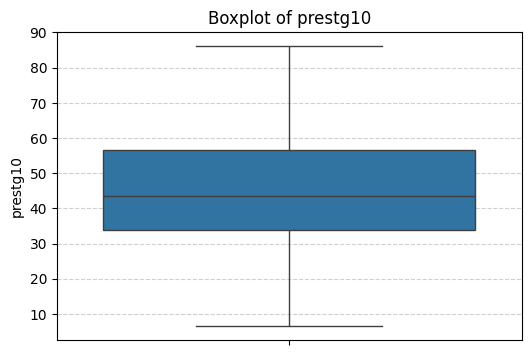

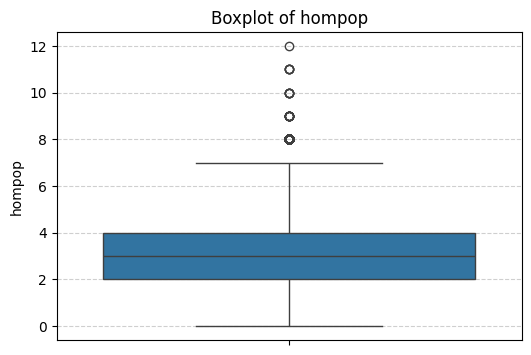

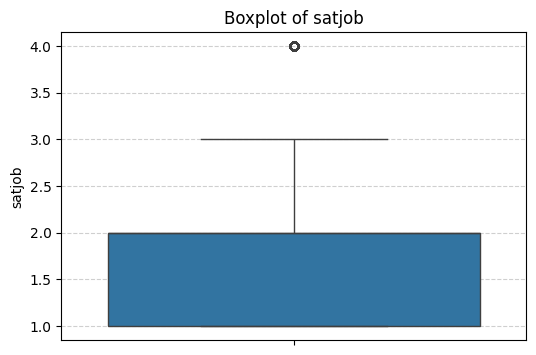

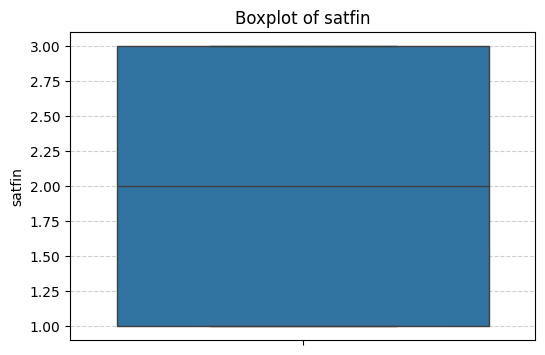

In [29]:
# Let's see the progress made:

num_df = dataset

for col in num_df.columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(y=num_df[col].dropna())
    plt.title(f"Boxplot of {col}")
    plt.ylabel(col)
    plt.grid(True, axis='y', linestyle='--', alpha=0.6)
    plt.show()

In [30]:
# Save the cleaned dataset
print("Final shape:", dataset.shape)
dataset.to_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

Final shape: (16773785, 24)


# Handling high correlations

In [31]:
# Figure out what attributes have high correlations

# Unstack and reset index to get pairs
hm = dataset.select_dtypes(include="number").corr()
corr_pairs = hm.unstack().reset_index()
corr_pairs.columns = ["Feature_1", "Feature_2", "Correlation"]

# Remove self-correlations (corr = 1.0)
corr_pairs = corr_pairs[corr_pairs["Feature_1"] != corr_pairs["Feature_2"]]

# Drop duplicate pairs (A–B and B–A)
corr_pairs = corr_pairs.drop_duplicates(subset=["Correlation"])

# Filter for strong correlations (absolute value > 0.7)
strong_corr = corr_pairs[abs(corr_pairs["Correlation"]) > 0.7]

# Sort by correlation strength
strong_corr = strong_corr.sort_values(by="Correlation", ascending=False)

print(strong_corr)

    Feature_1 Feature_2  Correlation
376      hrs2  weekswrk     0.807420
93     famgen    hompop     0.754512
476     sei10  prestg10     0.741306


In [32]:
# "prestg10" shows up more than any other feature; thus, it must be deleted to increase 
# the overal independence of the dataset attributes
dataset.drop(columns=["prestg10"], inplace=True)

In [33]:
# Let's re-compute the correlations
hm = dataset.select_dtypes(include="number").corr()

# Unstack and reset index to get pairs
corr_pairs = hm.unstack().reset_index()
corr_pairs.columns = ["Feature_1", "Feature_2", "Correlation"]

# Remove self-correlations (corr = 1.0)
corr_pairs = corr_pairs[corr_pairs["Feature_1"] != corr_pairs["Feature_2"]]

# Drop duplicate pairs (A–B and B–A)
corr_pairs = corr_pairs.drop_duplicates(subset=["Correlation"])

# Filter for strong correlations (absolute value > 0.7)
strong_corr = corr_pairs[abs(corr_pairs["Correlation"]) > 0.7]

# Sort by correlation strength
strong_corr = strong_corr.sort_values(by="Correlation", ascending=False)

print(strong_corr)

    Feature_1 Feature_2  Correlation
361      hrs2  weekswrk     0.807420
89     famgen    hompop     0.754512


In [34]:
# "famgen" represents the number of generations in the house;
# however, if the amount of people in the house "hompop" might matter more since it includes everybody
# who the responder might be financially supporting
dataset.drop(columns=["famgen"], inplace=True)

In [35]:
# Let's re-compute the correlations
hm = dataset.select_dtypes(include="number").corr()

# Unstack and reset index to get pairs
corr_pairs = hm.unstack().reset_index()
corr_pairs.columns = ["Feature_1", "Feature_2", "Correlation"]

# Remove self-correlations (corr = 1.0)
corr_pairs = corr_pairs[corr_pairs["Feature_1"] != corr_pairs["Feature_2"]]

# Drop duplicate pairs (A–B and B–A)
corr_pairs = corr_pairs.drop_duplicates(subset=["Correlation"])

# Filter for strong correlations (absolute value > 0.7)
strong_corr = corr_pairs[abs(corr_pairs["Correlation"]) > 0.7]

# Sort by correlation strength
strong_corr = strong_corr.sort_values(by="Correlation", ascending=False)

print(strong_corr)

    Feature_1 Feature_2  Correlation
323      hrs2  weekswrk      0.80742


              year   dwelown     phone       sex       age   marital  \
year      1.000000  0.007403  0.018917  0.011570  0.122318  0.063456   
dwelown   0.007403  1.000000 -0.088743  0.009266 -0.255200  0.271012   
phone     0.018917 -0.088743  1.000000  0.013928  0.052397 -0.061310   
sex       0.011570  0.009266  0.013928  1.000000 -0.005381  0.018570   
age       0.122318 -0.255200  0.052397 -0.005381  1.000000 -0.274501   
marital   0.063456  0.271012 -0.061310  0.018570 -0.274501  1.000000   
race      0.085320  0.130869 -0.017714  0.000894 -0.107287  0.062981   
hispanic  0.039117  0.109739 -0.018586 -0.003304 -0.087788  0.042496   
BPL       0.027958  0.085149 -0.000357 -0.007432 -0.014276 -0.045750   
degree    0.028486 -0.064912  0.045889  0.050020  0.023488 -0.067784   
wrkstat   0.017106 -0.020138 -0.008697  0.065572  0.238978 -0.025587   
wrkslf   -0.006464  0.058482 -0.009830  0.084478 -0.133638  0.071963   
occ10    -0.051876  0.045815 -0.035344 -0.153856 -0.038062  0.05

<Axes: >

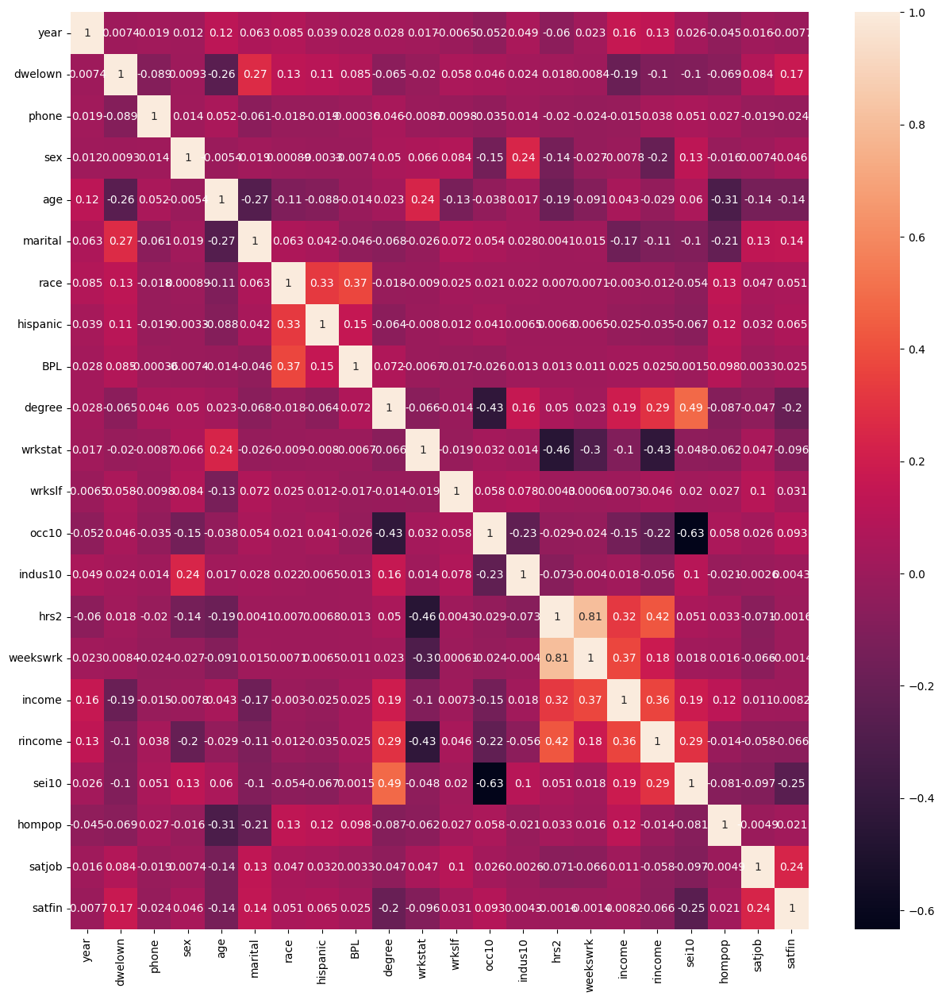

In [36]:
# Heat map of Correlations

hm = dataset.select_dtypes(include="number").corr()
print(hm)
plt.figure(figsize=(15,15))
sns.heatmap(hm, annot=True)

In [37]:
# Save the result
dataset.to_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

# Additional noise handling

In [38]:
# For debugging:
dataset = pd.read_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

In [39]:
# Let's handle logical contraictions, given all of the negative invalid values are handled already

print("Before")
check_num_of_Nones(dataset)

# Make a copy to avoid ruining the dataset because of a run-time error
cleaned = dataset.copy()

# 1. weeks worked cannot exceed 52
cleaned = cleaned[cleaned["weekswrk"] <= 52]

# 2. zero weekly hours but more than 1 working week
cleaned = cleaned[~((cleaned["hrs2"] == 0) & (cleaned["weekswrk"] > 1))]

# 3. underage working
cleaned = cleaned[~((cleaned["age"] < 14) & (cleaned["weekswrk"] > 0))]

# 4. no negative income or rincome
cleaned = cleaned[cleaned["income"] >= 0]
cleaned = cleaned[cleaned["rincome"] >= 0]

# 5. no negative status index
cleaned = cleaned[cleaned["sei10"] >= 0]

# 6. household population must be >= 1
cleaned = cleaned[cleaned["hompop"] >= 1]

# 7. working but zero weekly hours
cleaned = cleaned[~((cleaned["wrkstat"] == 1) & (cleaned["hrs2"] == 0))]

# 8. works for somebody but is marked as not working
cleaned = cleaned[~((cleaned["wrkslf"] == 2) & ((cleaned["wrkstat"] == 0) | (cleaned["wrkstat"] == 4)))]
print("# of removed samples: ", len(dataset) - len(cleaned), "\n")

dataset = cleaned

print("After")
check_num_of_Nones(dataset)

Before
Satjob:  satjob
1.0    2705
2.0    2138
3.0     494
4.0     232
Name: count, dtype: int64
Satfin:  satfin
2.0    3176
1.0    2113
3.0    1825
Name: count, dtype: int64
# of removed samples:  1448561 

After
Satjob:  satjob
1.0    2681
2.0    2124
3.0     491
4.0     227
Name: count, dtype: int64
Satfin:  satfin
2.0    3019
1.0    2036
3.0    1674
Name: count, dtype: int64


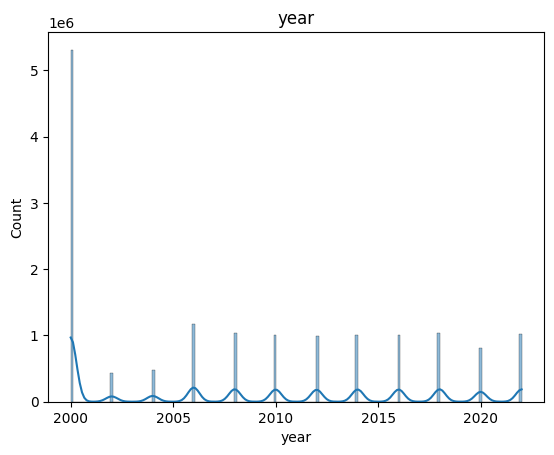

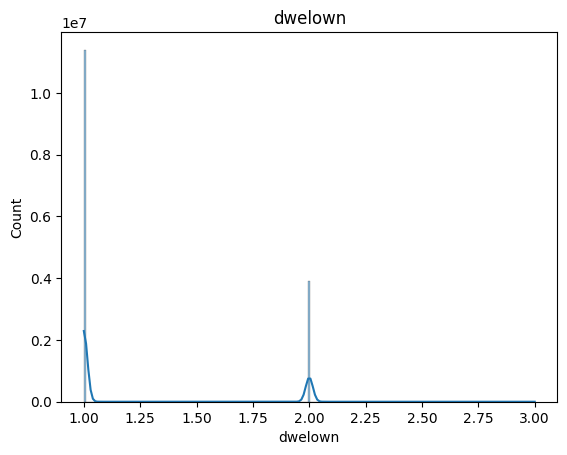

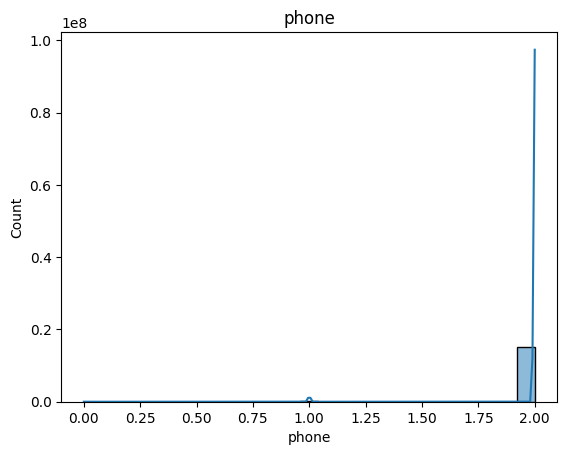

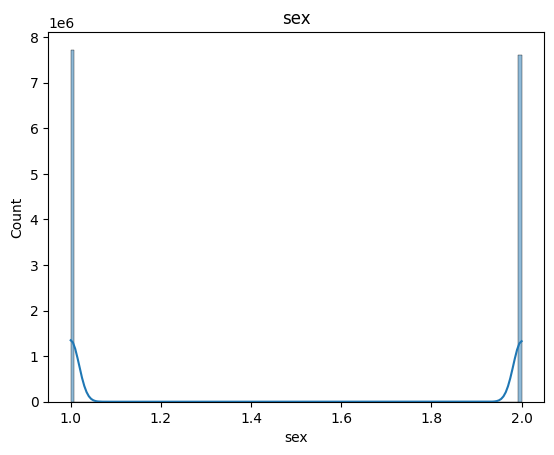

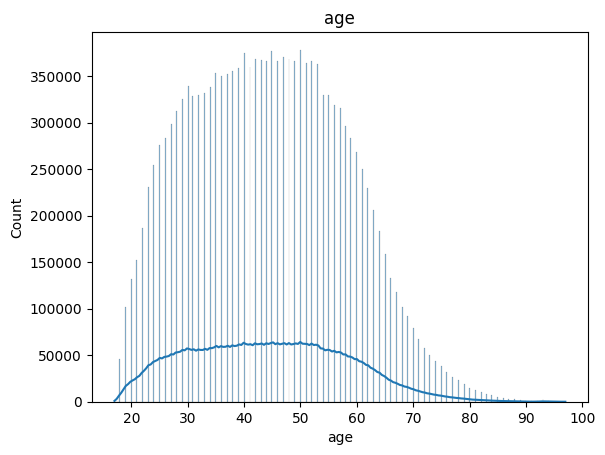

...

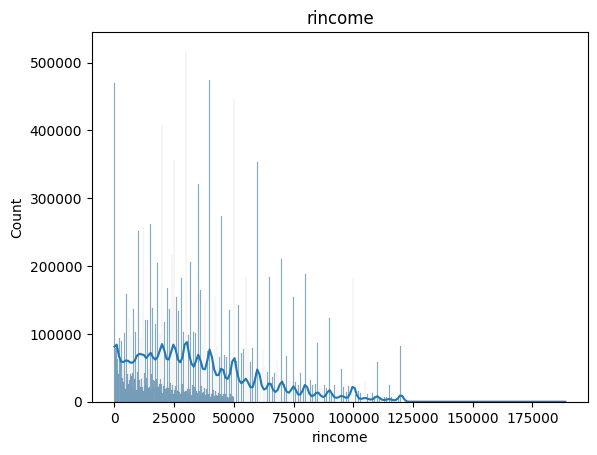

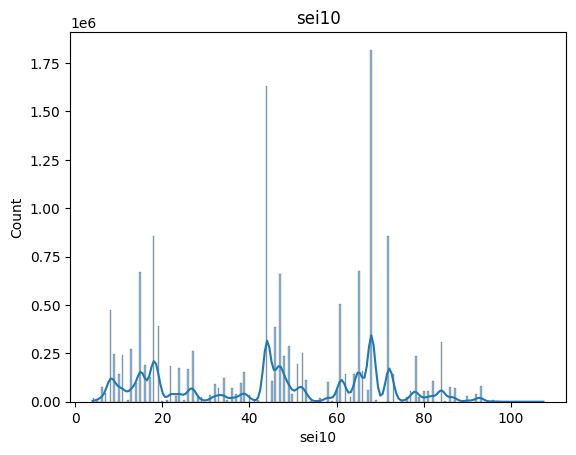

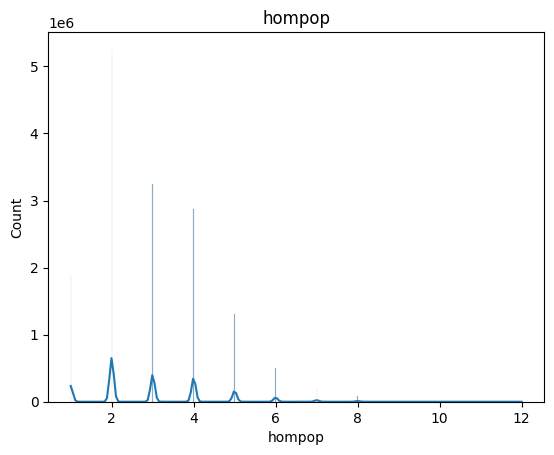

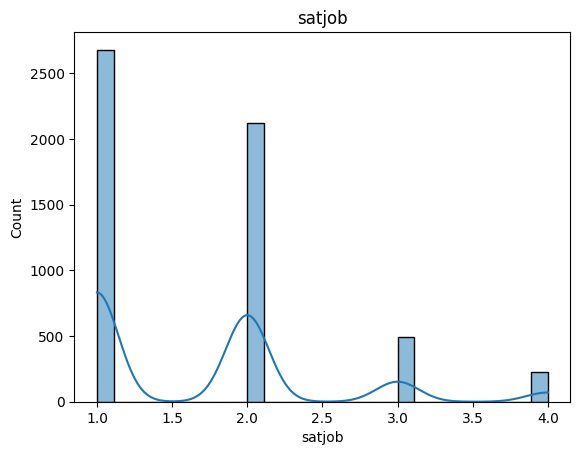

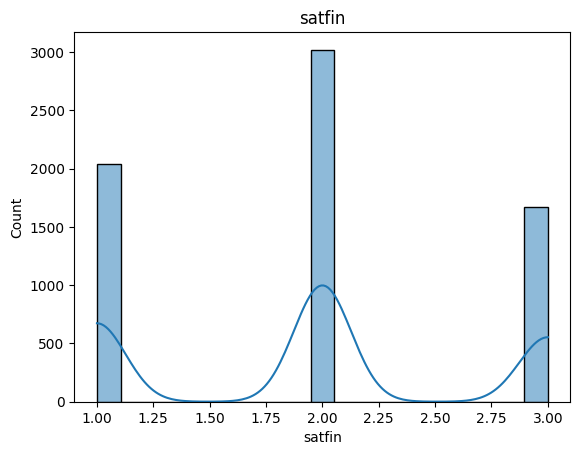

In [40]:
# Visualize distributions of values
for col in dataset.select_dtypes(include="number"):
    sns.histplot(dataset[col].dropna(), kde=True)
    plt.title(col)
    plt.show()

In [41]:
# Save the result
dataset.to_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

# Normalization

In [42]:
# Current variance:
print(dataset.var().sort_values(ascending=False))

income      4513362993.455257
rincome      710903783.038256
occ10          6775718.282377
BPL              15254.511569
sei10              543.744929
hrs2               386.782741
age                188.694629
year                59.266903
degree                 4.5739
marital              4.443348
indus10              3.452995
race                 3.046819
hompop               1.986617
weekswrk             0.805143
satjob               0.640047
satfin               0.548532
hispanic             0.524643
wrkstat              0.340301
sex                  0.249985
dwelown              0.190484
wrkslf               0.095226
phone                0.018189
dtype: Float64


In [43]:
# Current min and max per attribute
print(dataset.min())
print(dataset.max())

year          2000.0
dwelown          1.0
phone            0.0
sex              1.0
age             17.0
marital          1.0
race             1.0
hispanic         0.0
BPL              0.0
degree           1.0
wrkstat          0.0
wrkslf           1.0
occ10            2.0
indus10          1.0
hrs2             0.0
weekswrk    0.382942
income          -0.0
rincome         -0.0
sei10            4.0
hompop           1.0
satjob           1.0
satfin           1.0
dtype: Float64
year                2022.0
dwelown                3.0
phone                  2.0
sex                    2.0
age                   97.0
marital                6.0
race                   9.0
hispanic               4.0
BPL                  950.0
degree                 9.0
wrkstat                3.0
wrkslf                 5.0
occ10               9750.0
indus10               24.0
hrs2            926.930075
weekswrk              52.0
income      9018123.358551
rincome      188763.294629
sei10           107.442287
hompop    

In [44]:
# Go over the attributes that are numerically continuous

for col in continuous_numeric_attrs:
    # Compute the normalized values
    dataset[col] = (dataset[col] - dataset[col].min()) / (dataset[col].max() - dataset[col].min())

# Save the result
dataset.to_parquet("/Users/ruslanabdulin/Desktop/CSUN/Fall25/COMP541/data/df_preprocessed.parquet")

print(dataset.head())

    year  dwelown  phone  sex     age  marital  race  hispanic  BPL  degree  \
2   2000        1      2    2  0.3625        1     1         0   36       6   
3   2000        1      2    1  0.5625        1     1         0   44       7   
6   2000        1      2    2   0.425        4     1         0   44       5   
8   2000        2      2    2   0.125        6     1         0  542       7   
10  2000        2      2    2  0.0875        6     8         0   44       2   

    ...  occ10  indus10      hrs2  weekswrk    income   rincome     sei10  \
2   ...   2310        6  0.002158  0.050701  0.022621  0.005298  0.657371   
3   ...   5700        3  0.053942  0.050701  0.004735  0.225679  0.551032   
6   ...   3255        6  0.034523  0.050701  0.005877  0.233096  0.406024   
8   ...   2200        6  0.043153  0.050701  0.001885  0.090060  0.773378   
10  ...   5620        4  0.043153  0.050701  0.002950  0.140917  0.386689   

      hompop  satjob  satfin  
2   0.363636     NaN     NaN  


In [45]:
# Calculate variance
print(dataset.var().sort_values(ascending=False))

occ10       6775718.282377
BPL           15254.511569
year             59.266903
degree              4.5739
marital           4.443348
indus10           3.452995
race              3.046819
satjob            0.640047
satfin            0.548532
hispanic          0.524643
wrkstat           0.340301
sex               0.249985
dwelown           0.190484
wrkslf            0.095226
sei10             0.050816
age               0.029484
rincome           0.019952
phone             0.018189
hompop            0.016418
hrs2               0.00045
weekswrk          0.000302
income            0.000055
dtype: Float64


# Visualization

In [46]:
# Let's see what the value counts for every attribute after the modifications
for column in dataset.columns:
    print("\n\n", column, ": ", dataset[column].value_counts())



 year :  year
2000    5312273
2006    1172129
2008    1032548
2018    1030021
2022    1020278
2014    1012910
2016    1011475
2010    1007670
2012     989640
2020     817054
2004     479080
2002     439179
2021        967
Name: count, dtype: int64


 dwelown :  dwelown
1    11401373
2     3923843
3           8
Name: count, dtype: Int64


 phone :  phone
2    15043197
1      281379
0         648
Name: count, dtype: Int64


 sex :  sex
1    7722109
2    7603115
Name: count, dtype: Int64


 age :  age
0.4125    378348
0.35      377257
0.2875    374640
0.375     370618
0.3125    368806
           ...  
0.925        281
0.975        231
0.9875        11
0.0            2
1.0            1
Name: count, Length: 81, dtype: Int64


 marital :  marital
1    9191571
6    3329379
4    1882160
5     392488
3     305549
2     224077
Name: count, dtype: Int64


 race :  race
1    12290047
2     1352255
7      508281
6      451384
8      373157
4      144870
3      129759
5       44459
9       31012
N

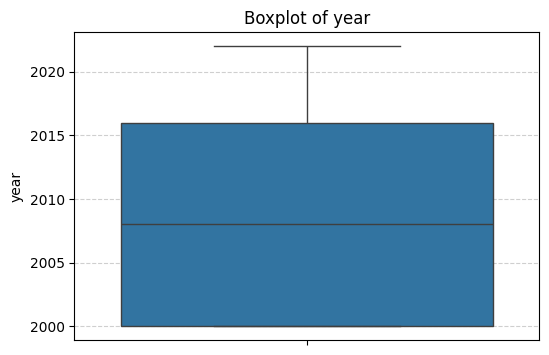

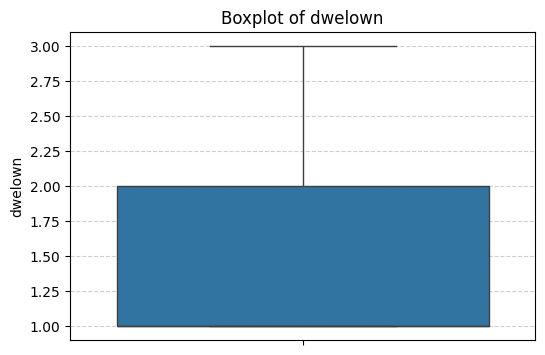

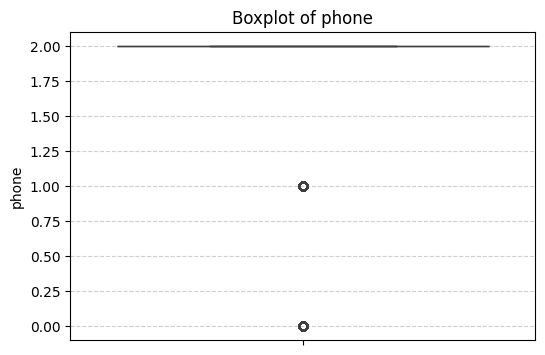

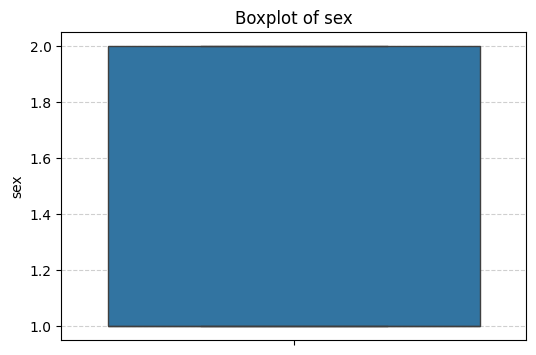

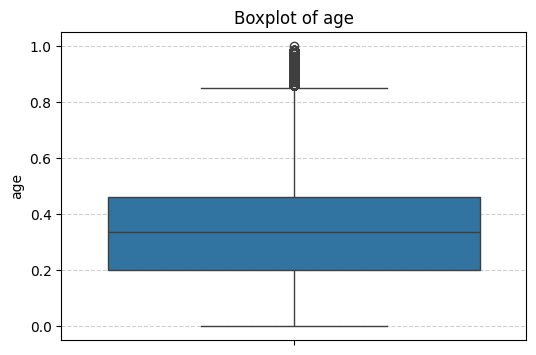

...

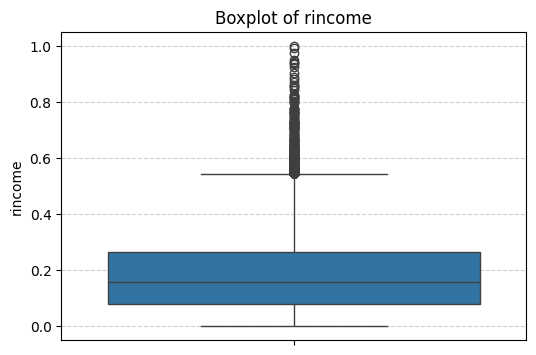

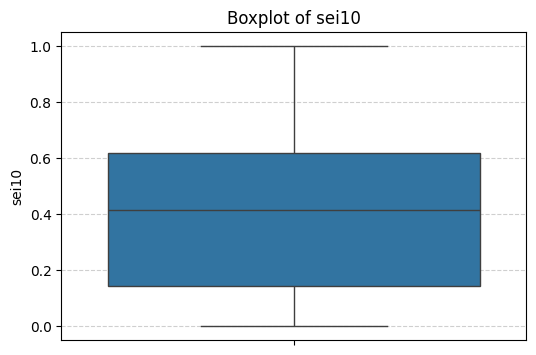

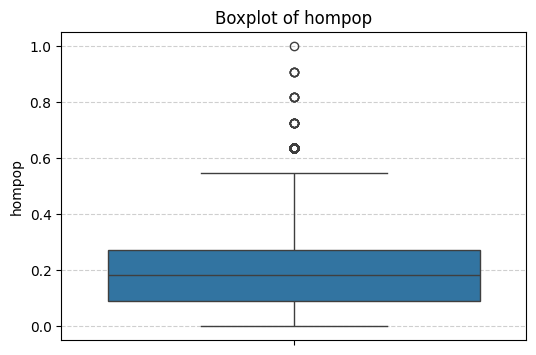

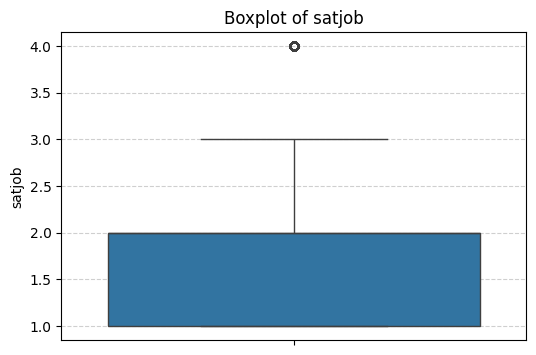

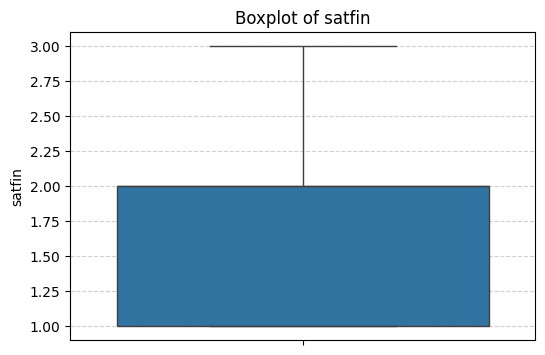

In [47]:
# Box-plot

num_df = dataset

for col in num_df.columns:
    plt.figure(figsize=(6, 4))
    sns.boxplot(y=num_df[col].dropna())
    plt.title(f"Boxplot of {col}")
    plt.ylabel(col)
    plt.grid(True, axis='y', linestyle='--', alpha=0.6)
    plt.show()

              year   dwelown     phone       sex       age   marital  \
year      1.000000  0.016693  0.016872  0.006632  0.080323  0.071640   
dwelown   0.016693  1.000000 -0.087769  0.006575 -0.254894  0.274438   
phone     0.016872 -0.087769  1.000000  0.014269  0.051994 -0.061410   
sex       0.006632  0.006575  0.014269  1.000000 -0.000250  0.022275   
age       0.080323 -0.254894  0.051994 -0.000250  1.000000 -0.288694   
marital   0.071640  0.274438 -0.061410  0.022275 -0.288694  1.000000   
race      0.090988  0.130759 -0.017551 -0.000834 -0.103082  0.063532   
hispanic  0.045442  0.109907 -0.018439 -0.005346 -0.083494  0.043174   
BPL       0.031949  0.085462 -0.000280 -0.010237 -0.007882 -0.044377   
degree    0.032776 -0.062166  0.045784  0.056078  0.023826 -0.063525   
wrkstat  -0.139382  0.003665 -0.016353  0.050868  0.119205 -0.010581   
wrkslf   -0.007653  0.060061 -0.010252  0.083757 -0.139669  0.073933   
occ10    -0.052942  0.043532 -0.035533 -0.156505 -0.035772  0.05

<Axes: >

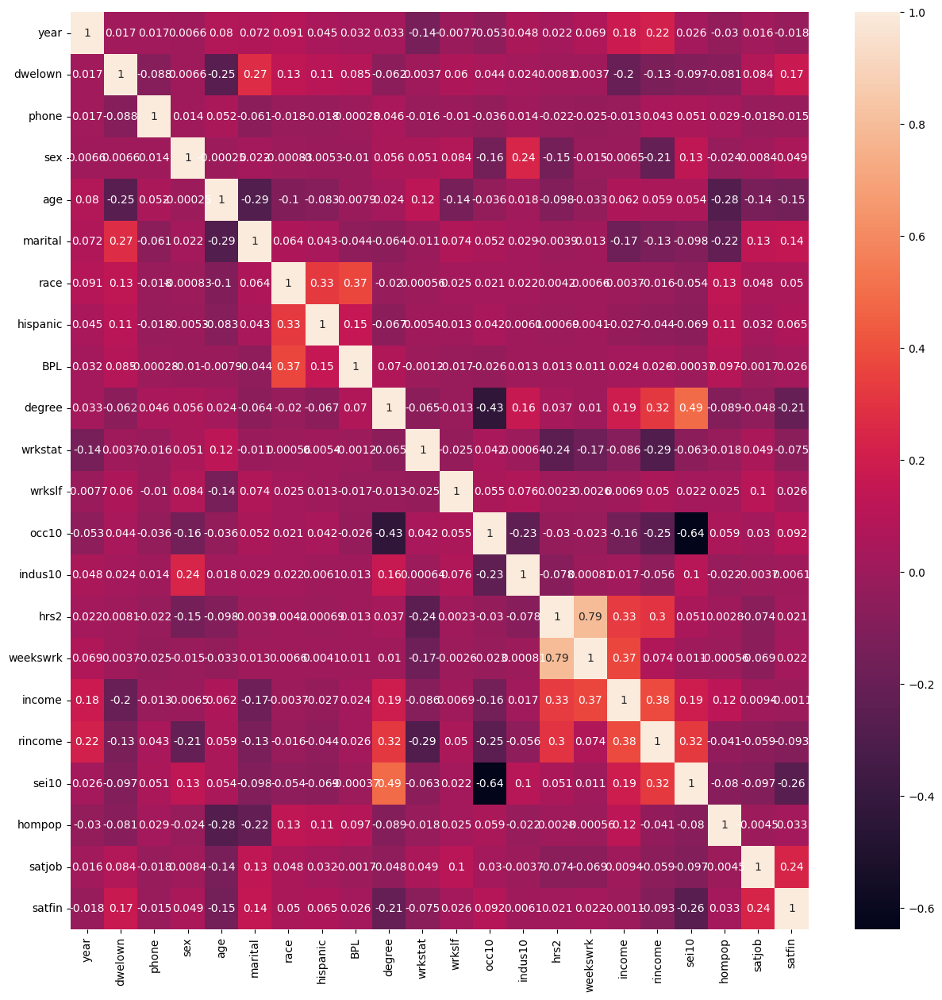

In [48]:
# Heat-map of the correliations

hm = dataset.select_dtypes(include="number").corr()
print(hm)
plt.figure(figsize=(15,15))
sns.heatmap(hm, annot=True)

In [49]:
dataset.dropna(axis=1, how='all').describe()

,year,dwelown,phone,sex,age,marital,race,hispanic,BPL,degree,...,occ10,indus10,hrs2,weekswrk,income,rincome,sei10,hompop,satjob,satfin
count,1.532522e+07,15325224.0,15325224.0,15325224.0,15325224.0,15325224.0,1.532522e+07,15325224.0,15325224.0,15325224.0,...,15325224.0,15325224.0,1.532522e+07,1.532522e+07,1.532522e+07,1.532522e+07,1.532522e+07,1.532522e+07,5523.000000,6729.000000
mean,2.008336e+03,1.256039,1.981555,1.496118,0.340584,2.611624,1.678034e+00,0.195148,70.8444,3.919815,...,4314.071118,5.101649,4.191523e-02,4.999702e-02,8.223401e-03,1.887338e-01,4.028806e-01,1.766607e-01,1.685678,1.946203
std,7.698500e+00,0.436445,0.134868,0.499985,0.171708,2.107925,1.745514e+00,0.724323,123.509156,2.138668,...,2603.020992,1.858224,2.121713e-02,1.738374e-02,7.449617e-03,1.412498e-01,2.254237e-01,1.281340e-01,0.800029,0.740630
min,2.000000e+03,1.0,0.0,1.0,0.0,1.0,1.000000e+00,0.0,0.0,1.0,...,2.0,1.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000,1.000000
25%,2.000000e+03,1.0,2.0,1.0,0.2,1.0,1.000000e+00,0.0,18.0,2.0,...,2310.0,4.0,3.883788e-02,5.070143e-02,4.346802e-03,7.946460e-02,1.450084e-01,9.090909e-02,1.000000,1.000000
50%,2.008000e+03,1.0,2.0,1.0,0.3375,1.0,1.000000e+00,0.0,36.0,4.0,...,4600.0,5.0,4.315320e-02,5.070143e-02,7.207708e-03,1.589292e-01,4.156907e-01,1.818182e-01,2.000000,2.000000
75%,2.016000e+03,2.0,2.0,2.0,0.4625,4.0,1.000000e+00,0.0,48.0,6.0,...,5820.0,6.0,4.746852e-02,5.070143e-02,1.108878e-02,2.648820e-01,6.187025e-01,2.727273e-01,2.000000,2.000000
max,2.022000e+03,3.0,2.0,2.0,1.0,6.0,9.000000e+00,4.0,950.0,9.0,...,9750.0,24.0,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,4.000000,3.000000


NaN remaining: 15325224
Sampled 50000 rows for t-SNE (original: 15325224)


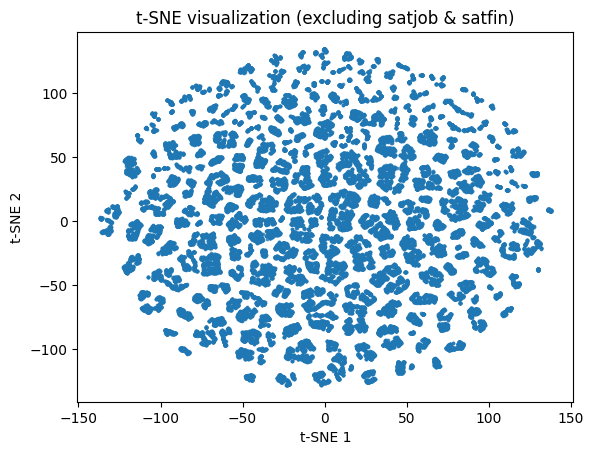

In [50]:
# T-SNE

from sklearn.manifold import TSNE

# Drop all-NaN columns, then remove satjob and satfin explicitly
cleaned = dataset.dropna(axis=1, how='all').drop(columns=["satjob", "satfin"], errors="ignore")

# Drop rows with any remaining NaNs (or use .fillna() if you prefer imputation)
print(f"NaN remaining: {len(cleaned.dropna())}")
cleaned = cleaned.dropna()

# Reduce size for performance – t-SNE is O(n^2)
MAX_ROWS = 50000
if len(cleaned) > MAX_ROWS:
    cleaned = cleaned.sample(MAX_ROWS, random_state=123)
    print(f"Sampled {MAX_ROWS} rows for t-SNE (original: {len(dataset)})")

# Run t-SNE
X_tsne = TSNE(n_components=2, random_state=123, perplexity=30).fit_transform(cleaned)

# Plot
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], s=3, alpha=0.7)
plt.title("t-SNE visualization (excluding satjob & satfin)")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.show()


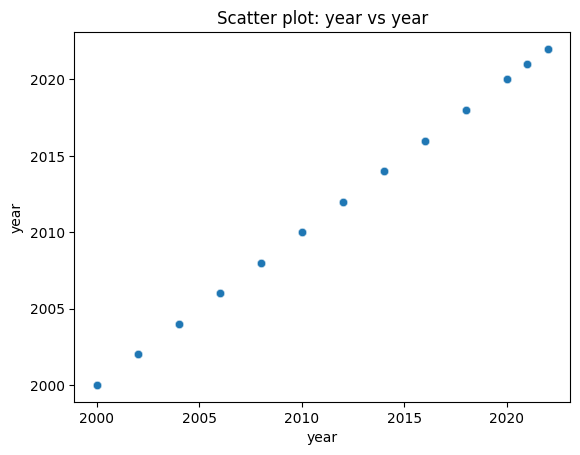

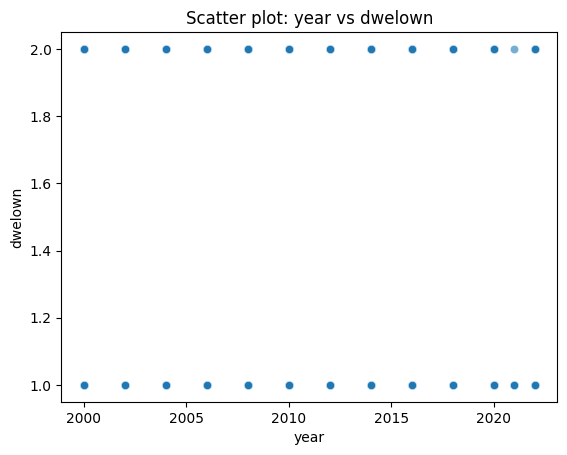

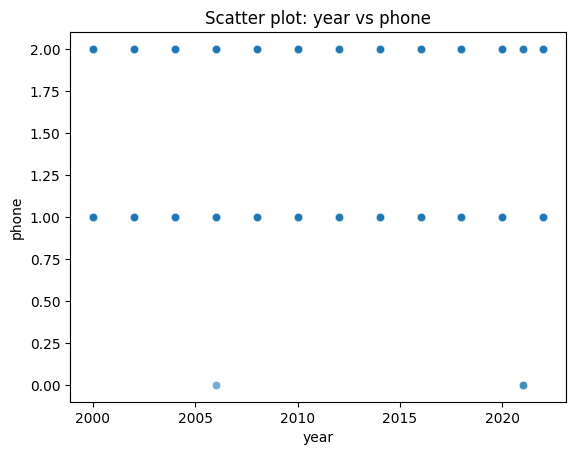

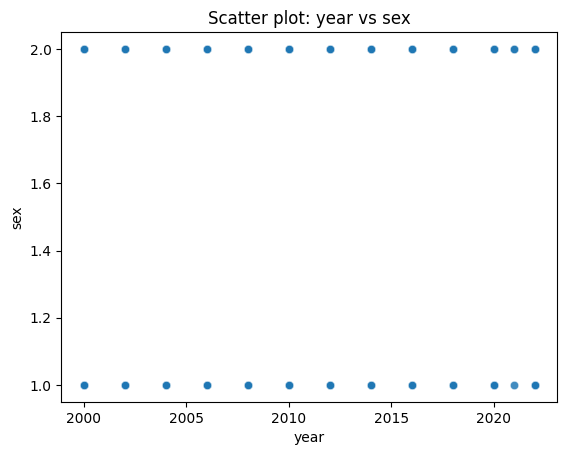

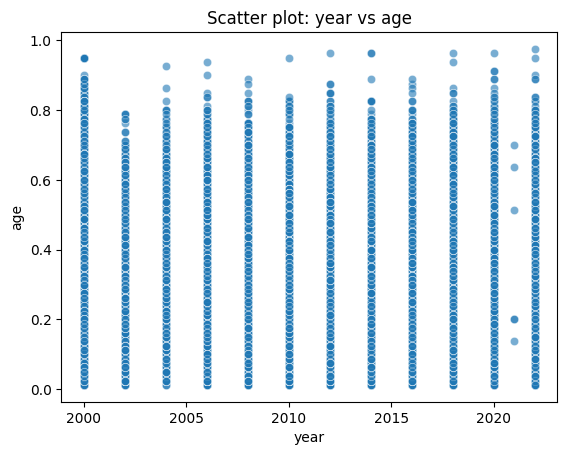

...

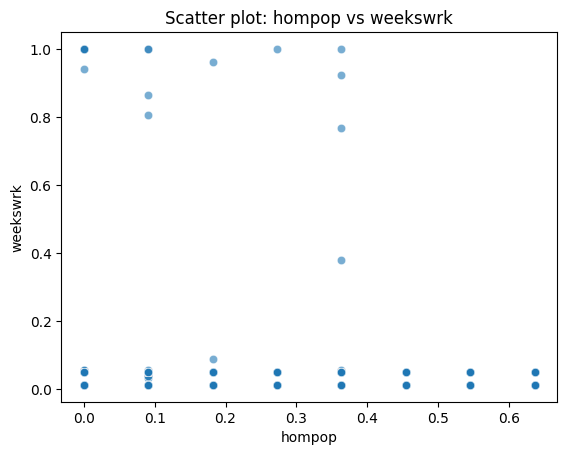

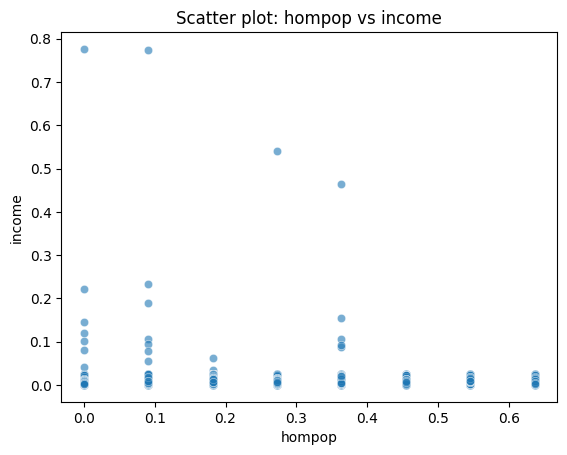

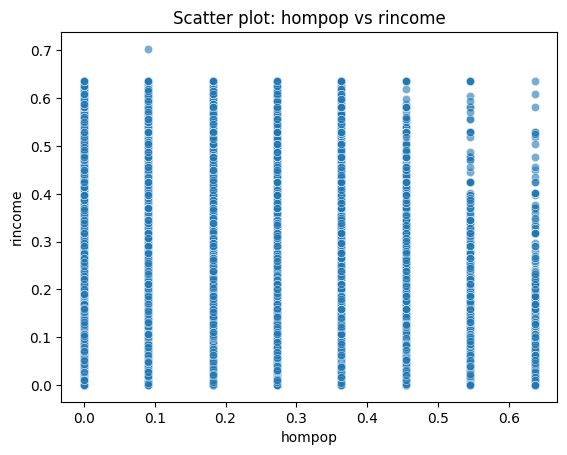

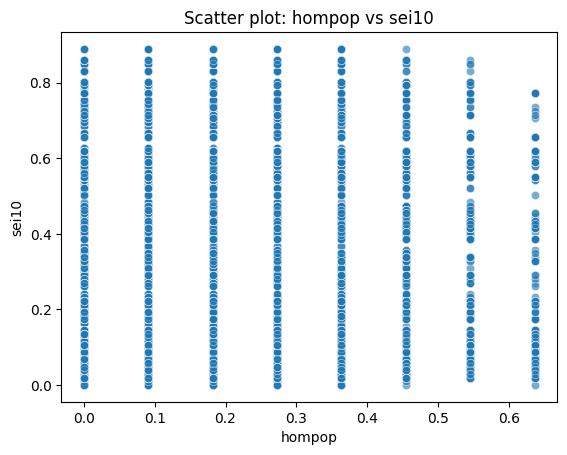

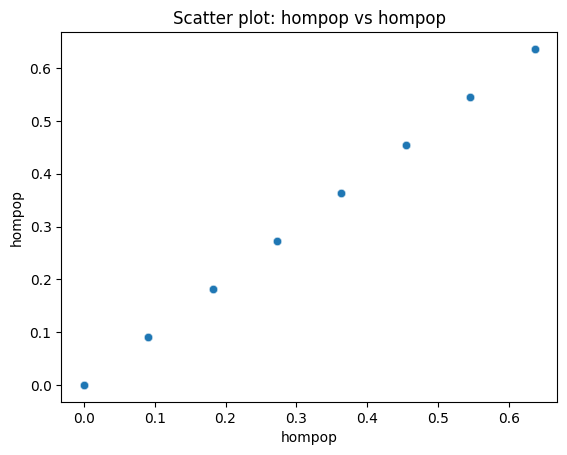

In [51]:
# Scatter-plot

for i in cleaned.columns:
    for j in cleaned.columns:
        sns.scatterplot(
            data=cleaned,
            x=i,   # choose your x-axis column
            y=j,    # choose your y-axis column
            alpha=0.6
        )
        plt.title(f"Scatter plot: {i} vs {j}")
        plt.show()

In [52]:
# Calculate variance
print(dataset.var().sort_values(ascending=False))

occ10       6775718.282377
BPL           15254.511569
year             59.266903
degree              4.5739
marital           4.443348
indus10           3.452995
race              3.046819
satjob            0.640047
satfin            0.548532
hispanic          0.524643
wrkstat           0.340301
sex               0.249985
dwelown           0.190484
wrkslf            0.095226
sei10             0.050816
age               0.029484
rincome           0.019952
phone             0.018189
hompop            0.016418
hrs2               0.00045
weekswrk          0.000302
income            0.000055
dtype: Float64


In [53]:
# Clustering

from sklearn.cluster import KMeans

num = dataset.drop(columns=["satjob", "satfin"], errors="ignore").select_dtypes(include="number")
num = num.dropna()
kmeans = KMeans(n_clusters=5, random_state=123)
data = kmeans.fit_predict(num)

sns.scatterplot(x='cluster', data=data)
plt.show()

TypeError: Data source must be a DataFrame or Mapping, not <class 'numpy.ndarray'>.

# Final NaN check

In [54]:
dataset.isnull().sum()

year               0
dwelown            0
phone              0
sex                0
age                0
marital            0
race               0
hispanic           0
BPL                0
degree             0
wrkstat            0
wrkslf             0
occ10              0
indus10            0
hrs2               0
weekswrk           0
income             0
rincome            0
sei10              0
hompop             0
satjob      15319701
satfin      15318495
dtype: int64